# <div align="center">You Only Edit Once</div>

<div align="center">

[![made-with-python](https://img.shields.io/badge/Made%20with-Python-blue.svg)](https://www.python.org/)
[![made-with-Markdown](https://img.shields.io/badge/Made%20with-Markdown-1f425f.svg)](http://commonmark.org)
[![Generic badge](https://img.shields.io/badge/STATUS-INPROGRESS-<COLOR>.svg)](https://shields.io/)
[![GitHub license](https://img.shields.io/github/license/teyang-lau/HDB_Resale_Prices.svg)](https://github.com/teyang-lau/HDB_Resale_Prices/blob/main/LICENSE)
<br>
[![Open in Streamlit](https://static.streamlit.io/badges/streamlit_badge_black_white.svg)](https://you-only-edit-once.streamlitapp.com/)
</div>

<p align="center">
  <img src="https://raw.githubusercontent.com/teyang-lau/you-only-edit-once/main/results/media/you-only-edit-once-ai-logo.png" width="300">
</p>
<br>

## <div align="center">YOEO Web Application</div>
  
<div align="center">
  <p>
    Check out the <b><a href="https://you-only-edit-once.streamlitapp.com/">You Only Edit Once web application</a></b> hosted on streamlit!
  </p>
</div>

# Setup

Clone GitHub [repository](https://github.com/teyang-lau/you-only-edit-once), install [dependencies](https://github.com/teyang-lau/you-only-edit-once/blob/main/requirements.txt).

In [1]:
!git clone https://github.com/teyang-lau/you-only-edit-once.git  # clone
%cd you-only-edit-once
# %pip install -qr requirements.txt  # install, but some packages are not compatible with colab

Cloning into 'you-only-edit-once'...
remote: Enumerating objects: 744, done.
remote: Counting objects: 100% (31/31), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 744 (delta 10), reused 31 (delta 10), pack-reused 713
Receiving objects: 100% (744/744), 199.26 MiB | 32.05 MiB/s, done.
Resolving deltas: 100% (346/346), done.
Checking out files: 100% (89/89), done.
/content/you-only-edit-once


In [2]:
# manual install required packages instead
!pip install youtube_dl
!pip install librosa
!pip install pydub
!pip install pafy
!pip install pilgram
!pip install loguru 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 5.1 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 817 kB 5.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 58 kB 2.8 MB/s 


# Import Modules

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import os
import sys
from IPython.display import HTML
from base64 import b64encode

from src.utils.streamlit import save_uploaded_file, factors, get_all_files, make_grid
from src.utils.yolox_process import video_predict
from src.utils.scoring_frames import scores_over_all_frames, filter_area_and_count
from src.utils.video_process import filter_video, add_audio
from src.utils.plotting import streamgraph
from src.utils.beautify import get_top_n_idx, beautify, check_filter
from yolox.models import YOLOX, YOLOPAFPN, YOLOXHead

# 1. Load Model

In [4]:
MODEL_PATH = "./results/models/yolox_dive.pth"
MODEL_INPUT_SIZE = (640, 640)  # width, height
NUM_CLASSES = 5
CONF_THRESHOLD = 0.25
NMS_THRESHOLD = 0.45
YOEO_CLASSES = (
    "shark",
    "coral",
    "fish",
    "turtle",
    "manta ray",
)

In [5]:
def load_model(ckpt_file, depth=0.33, width=0.25, num_classes=5):
    def init_yolo(M):
        for m in M.modules():
            if isinstance(m, nn.BatchNorm2d):
                m.eps = 1e-3
                m.momentum = 0.03

    in_channels = [256, 512, 1024]
    # NANO model use depthwise = True, which is main difference.
    backbone = YOLOPAFPN(depth, width, in_channels=in_channels, depthwise=True)
    head = YOLOXHead(num_classes, width, in_channels=in_channels, depthwise=True)
    model = YOLOX(backbone, head)

    model.apply(init_yolo)
    model.head.initialize_biases(1e-2)
    model.eval()

    ckpt = torch.load(ckpt_file, map_location="cpu")
    # load the model state dict
    model.load_state_dict(ckpt["model"])

    return model

model = load_model(MODEL_PATH)

# 2. Set User-Defined Parameters

In [10]:
VIDEO_FILE = "./results/media/demo_video_extended.mp4"
if not os.path.exists("./out"):
  os.mkdir("./out")
OD_PATH = "./out/od_video.mp4"
OD_PATH_RECODE = "./out/od_video_recode.mp4"

# PARAMETERS
MARINE_OPTIONS = ["Fish", "Coral", "Turtle", "Shark", "Manta Ray"]
IFPS = 24
STRICT_VAL = 72
ALGO = "Area & Count" 
FILTER = "Stinson" # instagram filter

marine_options_map = {
        "Shark": 0,
        "Corals": 1,
        "Fish": 2,
        "Turtle": 3,
        "Manta Ray": 4,
    }
MARINE_OPTIONS = [*map(marine_options_map.get, MARINE_OPTIONS)]

# 3. Run Inference On Video

In [11]:
bbox_class_score, origi_shape, fps, num_frames = video_predict(
  VIDEO_FILE,
  OD_PATH,
  model,
  NUM_CLASSES,
  CONF_THRESHOLD,
  NMS_THRESHOLD,
  MODEL_INPUT_SIZE,
  YOEO_CLASSES,
  IFPS,
  verbose=True,
)

842 frames detected!
--- Frame inferred in 0.51 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.23 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.20 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.24 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.22 seconds ---
--- Frame inferred in 0.21 seconds ---
--- Frame inferred in 0.21 seconds ---
--- 

In [20]:
# use ffmpeg to recode the output video
os.system(
    "ffmpeg -i {} -vcodec libx264 {}".format(
        OD_PATH,
        OD_PATH_RECODE,
    )
)

0

In [21]:
# Show video
mp4 = open(OD_PATH_RECODE,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# 4. Trim Video

In [14]:
# score the frames
(
    area_scores,
    count_scores,
    marine_mask,
    species_detected,
    species_count,
    species_count_reorder,
) = scores_over_all_frames(bbox_class_score, MARINE_OPTIONS, origi_shape)

# filter scores for each frame
filtered_scores, filtered_idx = filter_area_and_count(
    area_scores,
    species_count,
    marine_mask,
    1.1,
    STRICT_VAL,
    fps,
    IFPS,
    num_frames,
    algo=ALGO,
)

# get indices of randomly selected top frames
beauti_idx = get_top_n_idx(
    filtered_scores, filtered_idx, sampling_size=0.1, n=10
)

In [15]:
TRIMMED_VIDEO_PATH = "./out/video_trimmed.mp4"
TRIMMED_VIDEO_RECODED_PATH = "./out/video_trimmed_recoded.mp4"
TEMP_PATH = "./out" # for storing truncated/extended audio file

In [16]:
# filter and stitch video; also get the top frames for beautification
beauti_img = filter_video(
    VIDEO_FILE, TRIMMED_VIDEO_PATH, filtered_idx, beauti_idx
)

# add audio to video
AUDIO_FILE = "./results/media/Retreat.mp3"
add_audio(
    AUDIO_FILE,
    TRIMMED_VIDEO_PATH,
    TRIMMED_VIDEO_RECODED_PATH,
    TEMP_PATH,
)

In [17]:
# Show video
mp4 = open(TRIMMED_VIDEO_RECODED_PATH,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# 5. Beautify Images

In [ ]:
beauti_img = beautify(beauti_img, filter=FILTER)

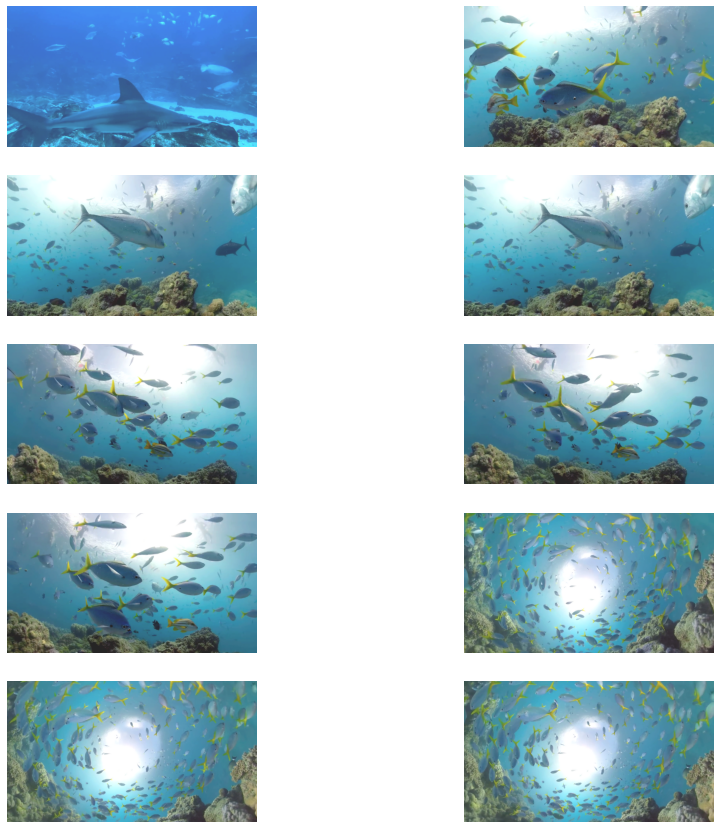

In [ ]:
row, col= 5, 2
fig, axes = plt.subplots(figsize = (15,15), nrows=row, ncols=col)
fig.patch.set_visible(False)
# axes.axis('off')
for idx, img in enumerate(beauti_img):
  axes[idx // col, idx % col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  axes[idx // col, idx % col].axis('off')
plt.show()

# About YOEO

<p align="center">
  <img src="https://raw.githubusercontent.com/teyang-lau/you-only-edit-once/main/results/media/you-only-edit-once-ai-logo.png" width="300">
</p>
<br>

**[YOEO (You Only Edit Once)](https://github.com/teyang-lau/you-only-edit-once)** is an AI diving object detection model and diving 
    video trimming web application created by data scientists and 
    AI practitioners who are diving enthusiasts!

<br>

**Created by:**
* HE Xinyi
* LAU TeYang
* LI Zihao
* LIM Hsien Yong
* YAN Licheng

<br>

The Model is trained on ~500 fully annotated images from raw diving videos using
    [YOLOX-Nano](https://github.com/Megvii-BaseDetection/YOLOX) for 300 epochs.